# U-net for parcellation
## + L-net for regression
  
  
  
    
  
- trained on cortical parcellations from Freesurfer
- finetuned on small dataset of "expert" hand-labels
- predicts output class for each pixel of input image

In [1]:
# I also like to live dangerously
import warnings
warnings.filterwarnings('ignore')

In [2]:
import unet

In [3]:
import dlutil
from dlutil.data import ToFloat
from dlutil.data import get_index_batches
from dlutil.data import BatchIndexSampler
from dlutil.utils import y_vis_sample, from_onehot

import torch
from torch.utils.data import Dataset, DataLoader

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision
import torchvision.transforms as transforms

# these are required for defining the regession ImageFolder
from typing import Dict, Any
from torchvision import datasets
from torchsummary import summary

In [4]:
import nilearn as ni
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

import os
import copy
import pickle
import collections

import numpy as np
import pandas as pd

from PIL import Image
from PIL import ImageOps
from PIL import ImagePalette

In [5]:
import nbutils
import datetime

## 1. Set up directories and process data

## 1.a HBN

In [6]:
# model directories

date = str(datetime.datetime.now().date())
model_save_dir = f'./models/model_only_curv_{date}'
os.makedirs(model_save_dir, exist_ok=True)

# data directories

base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas'
xdir = os.path.join(base_data_dir, 'xs')
ydir = os.path.join(base_data_dir, 'ys')
vdir = os.path.join(base_data_dir, 'px2v')
pdir = os.path.join(base_data_dir, 'pxcoord')

# freesurfer data directories
hbn_dir = '/oak/stanford/groups/jyeatman/HBN/BIDS_curated/derivatives/freesurfer'
hbn_surf_dir = 'surf'
hbn_parc_dir = 'label'

# data properties

in_channels = 5
out_channels = 21

In [7]:
merge_columns = ['EID', 'Angle1', 'Angle2']
filename_columns = ['Filename_x', 'Filename_y', 'Filename_v', 'Filename_p']

x_df = nbutils.get_subjects_df(xdir).rename({'Filename': filename_columns[0]}, axis=1)
y_df = nbutils.get_subjects_df(ydir).rename({'Filename': filename_columns[1]}, axis=1)
v_df = nbutils.get_subjects_df(vdir).rename({'Filename': filename_columns[2]}, axis=1)
p_df = nbutils.get_subjects_df(pdir).rename({'Filename': filename_columns[3]}, axis=1)

hbn_df = pd.merge(x_df, y_df, on=merge_columns, how='inner')
hbn_df = pd.merge(hbn_df, v_df, on=merge_columns, how='inner')
hbn_df = pd.merge(hbn_df, p_df, on=merge_columns, how='inner')

hbn_df = hbn_df[filename_columns + merge_columns]  # reorder columns
hbn_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2
0,sub-NDARLJ355VAG-218.41-82.39-curv.npy,sub-NDARLJ355VAG-218.41-82.39-parc.npy,sub-NDARLJ355VAG-218.41-82.39-px2v.pkl,sub-NDARLJ355VAG-218.41-82.39-pxcoord.npy,sub-NDARLJ355VAG,218.41,82.39
1,sub-NDARKN633WZA-201.56-87.93-curv.npy,sub-NDARKN633WZA-201.56-87.93-parc.npy,sub-NDARKN633WZA-201.56-87.93-px2v.pkl,sub-NDARKN633WZA-201.56-87.93-pxcoord.npy,sub-NDARKN633WZA,201.56,87.93
2,sub-NDARCJ330NBP-212.41-81.04-curv.npy,sub-NDARCJ330NBP-212.41-81.04-parc.npy,sub-NDARCJ330NBP-212.41-81.04-px2v.pkl,sub-NDARCJ330NBP-212.41-81.04-pxcoord.npy,sub-NDARCJ330NBP,212.41,81.04
3,sub-NDARRN598JXJ-207.12-98.81-curv.npy,sub-NDARRN598JXJ-207.12-98.81-parc.npy,sub-NDARRN598JXJ-207.12-98.81-px2v.pkl,sub-NDARRN598JXJ-207.12-98.81-pxcoord.npy,sub-NDARRN598JXJ,207.12,98.81
4,sub-NDARHB803UT9-212.04-93.64-curv.npy,sub-NDARHB803UT9-212.04-93.64-parc.npy,sub-NDARHB803UT9-212.04-93.64-px2v.pkl,sub-NDARHB803UT9-212.04-93.64-pxcoord.npy,sub-NDARHB803UT9,212.04,93.64


## 1.b OTS (FFK)

In [6]:
# model directories

date = str(datetime.datetime.now().date())
model_save_dir = f'./models/model_ots_mfs_gap_01_{date}'
os.makedirs(model_save_dir, exist_ok=True)

# data directories

base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas/ots-mfs-sulc'
xdir = os.path.join(base_data_dir, 'xs')
ydir = os.path.join(base_data_dir, 'ys')
vdir = os.path.join(base_data_dir, 'px2v')
pdir = os.path.join(base_data_dir, 'pxcoord')

# freesurfer data directories
ots_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/data/OTS_MFS/OTS_MFS__for__Sam'
ots_surf_dir = 'surf'
ots_parc_dir = 'label/manual_label'

# data properties

in_channels = 5
out_channels = 9

In [7]:
ots_parse_dict = {'EID': (lambda s: s.split('-')[0]), 
                  'Angle1': (lambda s: s.split('-')[1]), 
                  'Angle2': (lambda s: s.split('-')[2])
                 } 

In [10]:
merge_columns = ['EID', 'Angle1', 'Angle2']
filename_columns = ['Filename_x', 'Filename_y', 'Filename_v', 'Filename_p']

x_df = nbutils.get_subjects_df(xdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[0]}, axis=1)
y_df = nbutils.get_subjects_df(ydir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[1]}, axis=1)
v_df = nbutils.get_subjects_df(vdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[2]}, axis=1)
p_df = nbutils.get_subjects_df(pdir, extract_dict=ots_parse_dict).rename({'Filename': filename_columns[3]}, axis=1)

ots_df = pd.merge(x_df, y_df, on=merge_columns, how='inner')
ots_df = pd.merge(ots_df, v_df, on=merge_columns, how='inner')
ots_df = pd.merge(ots_df, p_df, on=merge_columns, how='inner')

ots_df = ots_df[filename_columns + merge_columns]  # reorder columns
ots_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2
0,6029_T3.long.6029-196.23-89.44-curv.npy,6029_T3.long.6029-196.23-89.44-parc.npy,6029_T3.long.6029-196.23-89.44-px2v.pkl,6029_T3.long.6029-196.23-89.44-pxcoord.npy,6029_T3.long.6029,196.23,89.44
1,6116_T3.long.6116-211.03-82.27-curv.npy,6116_T3.long.6116-211.03-82.27-parc.npy,6116_T3.long.6116-211.03-82.27-px2v.pkl,6116_T3.long.6116-211.03-82.27-pxcoord.npy,6116_T3.long.6116,211.03,82.27
2,5010_T3.long.5010-204.73-80.06-curv.npy,5010_T3.long.5010-204.73-80.06-parc.npy,5010_T3.long.5010-204.73-80.06-px2v.pkl,5010_T3.long.5010-204.73-80.06-pxcoord.npy,5010_T3.long.5010,204.73,80.06
3,5105_T3.long.5105-207.11-86.85-curv.npy,5105_T3.long.5105-207.11-86.85-parc.npy,5105_T3.long.5105-207.11-86.85-px2v.pkl,5105_T3.long.5105-207.11-86.85-pxcoord.npy,5105_T3.long.5105,207.11,86.85
4,5106_T3.long.5106-208.23-94.30-curv.npy,5106_T3.long.5106-208.23-94.30-parc.npy,5106_T3.long.5106-208.23-94.30-px2v.pkl,5106_T3.long.5106-208.23-94.30-pxcoord.npy,5106_T3.long.5106,208.23,94.30


## 1.0 Create test-train split respecting subject EIDs

In [11]:
eids = list(x_df['EID'].unique())

In [12]:
ntotal = len(eids)
ntest = ntotal // 4
ntrain = ntotal - ntest
test_eids = np.random.choice(eids, size=ntest, replace=False)
train_eids = list(set(eids) - set(test_eids))

In [13]:
len(test_eids), len(train_eids), len(eids)

(10, 30, 40)

In [14]:
ots_df['Train'] = ots_df['EID'].apply(lambda s: s in train_eids)
ots_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2,Train
0,6029_T3.long.6029-196.23-89.44-curv.npy,6029_T3.long.6029-196.23-89.44-parc.npy,6029_T3.long.6029-196.23-89.44-px2v.pkl,6029_T3.long.6029-196.23-89.44-pxcoord.npy,6029_T3.long.6029,196.23,89.44,True
1,6116_T3.long.6116-211.03-82.27-curv.npy,6116_T3.long.6116-211.03-82.27-parc.npy,6116_T3.long.6116-211.03-82.27-px2v.pkl,6116_T3.long.6116-211.03-82.27-pxcoord.npy,6116_T3.long.6116,211.03,82.27,True
2,5010_T3.long.5010-204.73-80.06-curv.npy,5010_T3.long.5010-204.73-80.06-parc.npy,5010_T3.long.5010-204.73-80.06-px2v.pkl,5010_T3.long.5010-204.73-80.06-pxcoord.npy,5010_T3.long.5010,204.73,80.06,True
3,5105_T3.long.5105-207.11-86.85-curv.npy,5105_T3.long.5105-207.11-86.85-parc.npy,5105_T3.long.5105-207.11-86.85-px2v.pkl,5105_T3.long.5105-207.11-86.85-pxcoord.npy,5105_T3.long.5105,207.11,86.85,True
4,5106_T3.long.5106-208.23-94.30-curv.npy,5106_T3.long.5106-208.23-94.30-parc.npy,5106_T3.long.5106-208.23-94.30-px2v.pkl,5106_T3.long.5106-208.23-94.30-pxcoord.npy,5106_T3.long.5106,208.23,94.30,False


In [7]:
# save mapping file for dataset construction
# with train / test split
# load previous files if they exist

save_not_load = False

# filepaths
# data_prefix = 'ots'
data_prefix = 'hbn'
# data_df = ots_df

trn_csv_fpath = f'{base_data_dir}/{data_prefix}_sulc_mapping_trn.csv'
val_csv_fpath = f'{base_data_dir}/{data_prefix}_sulc_mapping_val.csv'
    
# save or load
if save_not_load:

    data_df[data_df['Train']==True].to_csv(trn_csv_fpath, index=False)
    data_df[data_df['Train']==False].to_csv(val_csv_fpath, index=False)
    
else:
    
    trn_df = pd.read_csv(trn_csv_fpath)
    val_df = pd.read_csv(val_csv_fpath)
    
    trn_df['Train'] = True
    val_df['Train'] = False
    data_df = pd.concat([trn_df, val_df])

In [8]:
hbn_df = data_df
hbn_df.head()

,Filename_x,Filename_y,Filename_v,Filename_p,EID,Angle1,Angle2,Train
0,sub-NDARRB338YZ0-200.35-97.69-curv.npy,sub-NDARRB338YZ0-200.35-97.69-parc.npy,sub-NDARRB338YZ0-200.35-97.69-px2v.pkl,sub-NDARRB338YZ0-200.35-97.69-pxcoord.npy,sub-NDARRB338YZ0,200.35,97.69,True
1,sub-NDARAH976BND-220.09-86.08-curv.npy,sub-NDARAH976BND-220.09-86.08-parc.npy,sub-NDARAH976BND-220.09-86.08-px2v.pkl,sub-NDARAH976BND-220.09-86.08-pxcoord.npy,sub-NDARAH976BND,220.09,86.08,True
2,sub-NDARZM865KE8-224.20-100.12-curv.npy,sub-NDARZM865KE8-224.20-100.12-parc.npy,sub-NDARZM865KE8-224.20-100.12-px2v.pkl,sub-NDARZM865KE8-224.20-100.12-pxcoord.npy,sub-NDARZM865KE8,224.20,100.12,True
3,sub-NDARBV577EE0-221.30-80.79-curv.npy,sub-NDARBV577EE0-221.30-80.79-parc.npy,sub-NDARBV577EE0-221.30-80.79-px2v.pkl,sub-NDARBV577EE0-221.30-80.79-pxcoord.npy,sub-NDARBV577EE0,221.30,80.79,True
4,sub-NDARML626PGU-196.05-76.18-curv.npy,sub-NDARML626PGU-196.05-76.18-parc.npy,sub-NDARML626PGU-196.05-76.18-px2v.pkl,sub-NDARML626PGU-196.05-76.18-pxcoord.npy,sub-NDARML626PGU,196.05,76.18,True


## 1.1 Create datasets

In [9]:
from dlutil.data import aggregate_classes, _make_agg_matrix

n_orig_classes = out_channels
fg_agg_dict = {0: [0], 1: list(range(1, out_channels))}
n_agg_classes = len(fg_agg_dict)

null_agg_dict = {i: [i] for i in range(n_orig_classes)}
hbn_agg_dict = null_agg_dict
ots_agg_dict = {0: [0], 1: [1], 2: [2, 3, 4, 5, 6], 3: [7], 4: [8]}
keep_channels = [0, 1, 2]

In [10]:
trf = transforms.Compose([transforms.ToTensor(), 
                          dlutil.data.ToFloat()])
target_trf = transforms.Compose([transforms.ToTensor(), 
                                 dlutil.data.ToLong()])

In [11]:
ds_trn = dlutil.data.CustomUnetDataset(xdir=xdir, ydir=ydir,
                                       mapping_file=trn_csv_fpath,
                                       transform=trf,
                                       target_transform=target_trf, 
                                       nclasses=out_channels,
                                       agg_dict=hbn_agg_dict, 
                                       keep_channels=keep_channels
                                      )

ds_val = dlutil.data.CustomUnetDataset(xdir=xdir, ydir=ydir,
                                       mapping_file=val_csv_fpath,
                                       transform=trf,
                                       target_transform=target_trf, 
                                       nclasses=out_channels,
                                       agg_dict=hbn_agg_dict,
                                       keep_channels=keep_channels
                                      )

In [12]:
len(ds_trn), len(ds_val)

(139485, 15580)

In [13]:
# create dataloaders

shuffle_train = False

bs = 32
nw = 3  # number of cpu's to use to parallelize dl
pm = False  # whether to pin memory in dl

dl_train = DataLoader(ds_trn, batch_size=bs, shuffle=shuffle_train, pin_memory=pm)
dl_test = DataLoader(ds_val, batch_size=bs, shuffle=False, pin_memory=pm)

In [14]:
# create subject-group dataloader for val and trn set

df_val = ds_val.xy_pairs
gp_ind = get_index_batches(df_val, group_name='EID')
s_bind = BatchIndexSampler(gp_ind)

df_trn = ds_trn.xy_pairs
gp_trn_ind = get_index_batches(df_trn, group_name='EID')
s_trn_bind = BatchIndexSampler(gp_trn_ind)

dl_val_eid_batches = DataLoader(ds_val, batch_sampler=s_bind)
di_val_eid_batches = iter(dl_val_eid_batches)

dl_trn_eid_batches = DataLoader(ds_trn, batch_sampler=s_trn_bind)
di_trn_eid_batches = iter(dl_trn_eid_batches)

## 1.2 Visualize arrays

In [80]:
di_test = iter(dl_test)
xte, yte = next(di_test)

In [81]:
xte.shape, yte.shape, xte.dtype, yte.dtype

(torch.Size([32, 3, 256, 256]),
 torch.Size([32, 21, 256, 256]),
 torch.float32,
 torch.float32)

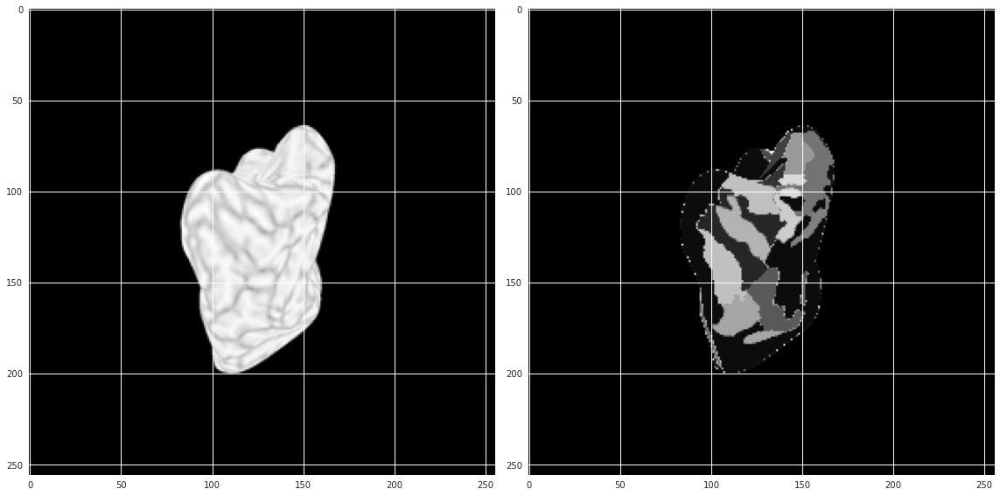

In [84]:
i_sample = 0
i_channel = 0

fig, ax = plt.subplots(1, 2, figsize=(16, 8))
ax[0].imshow(xte[i_sample, i_channel])
ax[1].imshow(yte.argmax(dim=1)[i_sample], cmap='gray') # cmap='tab20'
plt.tight_layout()

## 2. Define Unet and train

In [43]:
xtr, ytr = next(iter(dl_train))
xte, yte = next(iter(dl_test))

in_channels = xte.shape[1]
out_channels_agg = yte.shape[1]
xtr.shape, ytr.shape, xte.shape, yte.shape

(torch.Size([32, 3, 256, 256]),
 torch.Size([32, 5, 256, 256]),
 torch.Size([32, 3, 256, 256]),
 torch.Size([32, 5, 256, 256]))

In [44]:
model = unet.UNet(feature_count=in_channels, class_count=out_channels_agg, apply_sigmoid=False)
device = dlutil.utils.get_device()
device

device(type='cuda', index=0)

In [45]:
model.to(device)

UNet(
  (base_model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

In [46]:
def get_last_fns(model_load_dir, return_optim=True):
    """ Selects the latest model and load files
        from a given directory, returning them
        as a tuple of filenames.
    """
    import os
    fns = os.listdir(model_load_dir)
    opt = []
    if return_optim:
        opt = sorted([fn for fn in fns if 'optim' in fn])[-1]
    mod = sorted([fn for fn in fns if 'model' in fn])[-1] 
    return mod, opt

In [60]:
os.listdir('models')

['model_ots_fixed_inputs_unfreeze_last_3_2022-11-13',
 'model_ots_mfs_gap_2022-11-22',
 'model_only_curv_2022-11-13',
 'model_omit_binary_curv_2022-11-21',
 'model_2022-11-13',
 'model_ots_mfs_gap_all_channels_2022-11-24',
 'model_2022-11-04',
 'model_ots_mfs_gap_2022-11-21',
 'model_only_curv_continuation_2022-11-06',
 'model_2022-10-29',
 'model_only_curv_2022-11-21',
 'model_2022-11-14',
 'model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_2022-11-13',
 'model_only_curv_2022-11-06',
 'model_2022-10-26',
 'model_2022-10-31',
 'model_2022-10-11',
 'model_ots_fixed_inputs_2022-11-10',
 'model_2022-10-23',
 'model_2022-10-27',
 'model_2022-11-08',
 'model_only_curv_2022-11-22',
 'model_2022-10-12',
 'model_2022-10-25',
 'model_ots_mfs_gap_abbreviated_training_reweight_2022-11-22',
 'model_2022-11-10',
 'model_all_channels_2022-11-23',
 'model_2022-10-24',
 'model_omit_binary_curv_2022-11-06',
 'model_2022-10-20',
 'model_2022-11-07',
 'model_only_continuous_curv_2022-11-21',
 'model

In [47]:
reload_parameters = True
cpu = (device.type == 'cpu') 
device_string = 'cuda' if not cpu else 'cpu'  # in case model is saved from GPU but reloaded to CPU

if reload_parameters:
    
    model_load_dir = './models/model_only_curv_2022-11-26'
    # model_load_dir = './models/model_omit_binary_curv_2022-11-06'
    # model_load_dir = './models/model_only_curv_2022-11-06'
    # model_load_dir = './models/model_only_continuous_curv_2022-11-21'
    # model_load_dir = model_save_dir
    model_state_fn, optim_state_fn = get_last_fns(model_load_dir)

    # reload model state dict
    with open(f'{model_load_dir}/{model_state_fn}', 'rb') as f:
        model_reload_dict = torch.load(f, map_location=torch.device(device_string))

    # reload optimizer state dict
    with open(f'{model_load_dir}/{optim_state_fn}', 'rb') as f:
        optim_reload_dict = torch.load(f, map_location=torch.device(device_string))

In [49]:
discard_keywords = ['conv_last', 'conv_original', 'conv_up']
# discard_keywords = ['conv_last']

In [50]:
pretrained_params = model_reload_dict
discard_keys = []
for kw in discard_keywords:
    discard_keys += [k for k in list(pretrained_params.keys()) if kw in k]

for k in discard_keys:
    pretrained_params.pop(k, None)

discard_keys, discard_keys[0] in pretrained_params.keys(), discard_keys[1] in pretrained_params.keys()

(['conv_last.weight',
  'conv_last.bias',
  'conv_original_size0.0.weight',
  'conv_original_size0.0.bias',
  'conv_original_size1.0.weight',
  'conv_original_size1.0.bias',
  'conv_original_size2.0.weight',
  'conv_original_size2.0.bias',
  'conv_up3.0.weight',
  'conv_up3.0.bias',
  'conv_up2.0.weight',
  'conv_up2.0.bias',
  'conv_up1.0.weight',
  'conv_up1.0.bias',
  'conv_up0.0.weight',
  'conv_up0.0.bias'],
 False,
 False)

In [51]:
def make_pretrained_state_dict(model_state, pretrained_state):
    pd = pretrained_state
    sd = model_state
    warmstart_params = copy.deepcopy(sd)
    for k, v in pd.items():
        warmstart_params[k] = v
    return warmstart_params

warmstart_params = make_pretrained_state_dict(model.state_dict(), pretrained_params)
model.load_state_dict(warmstart_params)

<All keys matched successfully>

In [59]:
rename_save_dir = True
if rename_save_dir:
    model_save_dir = f'./models/model_ots_mfs_gap_02_0bce_{date}'
os.makedirs(model_save_dir, exist_ok=True)

In [60]:
# freeze all but the last layer
unfreeze_layers = [
    model.conv_last,
    model.conv_original_size0, 
    model.conv_original_size1, 
    model.conv_original_size2,
    model.conv_up0,
    model.conv_up1,
    model.conv_up2,
    model.conv_up3
]

unfreeze_layers_last = [
    model.conv_last 
]

dlutil.utils.set_unfreeze_(model, unfreeze_layers)

# confirm correct freeze / unfreeze
dlutil.utils.check_requires_grad(model.conv_last), \
dlutil.utils.check_requires_grad(model.conv_original_size0), \
dlutil.utils.check_requires_grad(model.conv_up3)

(True, True, True)

In [61]:
# data dictionaries formatted for input to training loop
dl_dict = {'trn': dl_train, 'val': dl_test}
class_weights = np.array([1.0, 1.0, 10.0, 4.0, 4.0])

# training proceeds along this plan
# shifts weight from bcd to dice
training_plan = [
    dict(lr=0.00375, gamma=0.9, num_batches=int(1e4), bce_weight=0.67),
    dict(lr=0.00250, gamma=0.9, num_batches=int(1e4), bce_weight=0.33),
    dict(lr=0.00125, gamma=0.9, num_batches=int(1e4), bce_weight=0.00)
]

training_plan_short = [
    # dict(lr=0.00375, gamma=0.9, num_batches=int(2e3), bce_weight=0.33) 
    dict(lr=0.00250, gamma=0.9, num_batches=int(2e3), bce_weight=0.00)
]

In [62]:
train = True
reload_optimizer_state = False

if train:
    
    tp = training_plan_short  # abbreviated for testing
    for e, t in enumerate(tp):

        # get hyperparameters
        lr = t['lr']
        gamma = t['gamma']
        bce_weight = t['bce_weight']
        num_batches = t['num_batches']

        # define training objects
        optimizer = torch.optim.Adam(
            filter(lambda p: p.requires_grad, model.parameters()), lr=lr)

        # initialize optimizer
        if reload_optimizer_state and (e == 0):
            optimizer.load_state_dict(optim_reload_dict)

        # other parameters
        step_size = len(dl_dict['trn']) 
        scheduler = torch.optim.lr_scheduler.StepLR(
            optimizer,
            step_size=step_size,
            gamma=gamma)

        # train loop
        result = unet.train.train_model(model, 
                                        optimizer, 
                                        scheduler, 
                                        dl_dict, 
                                        save_path=model_save_dir, 
                                        report_every=5, 
                                        checkpoint_every=100, 
                                        logits=True,
                                        num_batches=num_batches, 
                                        class_weights=class_weights,
                                        logger=None)
        model, best_dice, best_bce, losses = result

Train loss: 0.10027; Val loss: 0.31782; Val bce: 0.03517; Val dice: 0.60048
Train loss: 0.14238; Val loss: 0.18437; Val bce: 0.01679; Val dice: 0.35195
Train loss: 0.13443; Val loss: 0.17572; Val bce: 0.01717; Val dice: 0.33427
Train loss: 0.15462; Val loss: 0.16512; Val bce: 0.01678; Val dice: 0.31346
Train loss: 0.11362; Val loss: 0.17229; Val bce: 0.01411; Val dice: 0.33047
Train loss: 0.13303; Val loss: 0.16543; Val bce: 0.01390; Val dice: 0.31696
Train loss: 0.09753; Val loss: 0.17443; Val bce: 0.01344; Val dice: 0.33541
Train loss: 0.09582; Val loss: 0.16126; Val bce: 0.01265; Val dice: 0.30986
Train loss: 0.12715; Val loss: 0.16921; Val bce: 0.01205; Val dice: 0.32637
Train loss: 0.09880; Val loss: 0.17210; Val bce: 0.01204; Val dice: 0.33216
Train loss: 0.11602; Val loss: 0.17491; Val bce: 0.01348; Val dice: 0.33634
Train loss: 0.09120; Val loss: 0.01650; Val bce: 0.00110; Val dice: 0.03190
Train loss: 0.08588; Val loss: 0.15834; Val bce: 0.01267; Val dice: 0.30402
Train loss: 

Train loss: 0.06135; Val loss: 0.16816; Val bce: 0.01495; Val dice: 0.32138
Train loss: 0.07132; Val loss: 0.16603; Val bce: 0.01468; Val dice: 0.31739
Train loss: 0.08022; Val loss: 0.16532; Val bce: 0.01480; Val dice: 0.31583
Train loss: 0.06714; Val loss: 0.16616; Val bce: 0.01481; Val dice: 0.31750
Train loss: 0.06543; Val loss: 0.17025; Val bce: 0.01534; Val dice: 0.32515
Train loss: 0.05127; Val loss: 0.17037; Val bce: 0.01604; Val dice: 0.32469
Train loss: 0.04282; Val loss: 0.16638; Val bce: 0.01458; Val dice: 0.31819
Train loss: 0.04618; Val loss: 0.16743; Val bce: 0.01510; Val dice: 0.31976
Train loss: 0.04823; Val loss: 0.16992; Val bce: 0.01545; Val dice: 0.32439
Train loss: 0.04315; Val loss: 0.16744; Val bce: 0.01478; Val dice: 0.32009
Train loss: 0.04378; Val loss: 0.17055; Val bce: 0.01492; Val dice: 0.32618
Train loss: 0.03617; Val loss: 0.17098; Val bce: 0.01537; Val dice: 0.32658
Train loss: 0.06008; Val loss: 0.16850; Val bce: 0.01517; Val dice: 0.32183
Train loss: 

Train loss: 0.03436; Val loss: 0.17016; Val bce: 0.01594; Val dice: 0.32438
Train loss: 0.04532; Val loss: 0.17070; Val bce: 0.01585; Val dice: 0.32555
Train loss: 0.06227; Val loss: 0.17107; Val bce: 0.01598; Val dice: 0.32615
Train loss: 0.04577; Val loss: 0.17024; Val bce: 0.01581; Val dice: 0.32467
Train loss: 0.04861; Val loss: 0.17017; Val bce: 0.01563; Val dice: 0.32470
Train loss: 0.07252; Val loss: 0.17080; Val bce: 0.01580; Val dice: 0.32580
Train loss: 0.03746; Val loss: 0.17041; Val bce: 0.01588; Val dice: 0.32494
Train loss: 0.04846; Val loss: 0.17008; Val bce: 0.01588; Val dice: 0.32428
Train loss: 0.06109; Val loss: 0.17029; Val bce: 0.01587; Val dice: 0.32471
Train loss: 0.04503; Val loss: 0.17006; Val bce: 0.01587; Val dice: 0.32425
Train loss: 0.04733; Val loss: 0.17014; Val bce: 0.01592; Val dice: 0.32436
Train loss: 0.06162; Val loss: 0.17009; Val bce: 0.01597; Val dice: 0.32420
Train loss: 0.04407; Val loss: 0.16976; Val bce: 0.01588; Val dice: 0.32364
Train loss: 

Train loss: 0.04968; Val loss: 0.17080; Val bce: 0.01605; Val dice: 0.32556
Train loss: 0.05874; Val loss: 0.17070; Val bce: 0.01602; Val dice: 0.32538
Train loss: 0.06273; Val loss: 0.17083; Val bce: 0.01611; Val dice: 0.32556
Train loss: 0.04872; Val loss: 0.17071; Val bce: 0.01609; Val dice: 0.32533
Train loss: 0.05228; Val loss: 0.17001; Val bce: 0.01599; Val dice: 0.32402
Train loss: 0.03882; Val loss: 0.16991; Val bce: 0.01594; Val dice: 0.32389
Train loss: 0.04594; Val loss: 0.17053; Val bce: 0.01600; Val dice: 0.32505
Train loss: 0.06866; Val loss: 0.17084; Val bce: 0.01602; Val dice: 0.32566
Train loss: 0.06785; Val loss: 0.17055; Val bce: 0.01604; Val dice: 0.32507
Train loss: 0.04473; Val loss: 0.17042; Val bce: 0.01609; Val dice: 0.32475
Train loss: 0.05431; Val loss: 0.17057; Val bce: 0.01610; Val dice: 0.32504
Train loss: 0.06054; Val loss: 0.16976; Val bce: 0.01598; Val dice: 0.32355
Train loss: 0.03293; Val loss: 0.16970; Val bce: 0.01594; Val dice: 0.32345
Train loss: 

## 3. Investigate results

In [23]:
# options:
os.listdir('models')

['model_ots_fixed_inputs_unfreeze_last_3_2022-11-13',
 'model_ots_mfs_gap_2022-11-22',
 'model_only_curv_2022-11-13',
 'model_omit_binary_curv_2022-11-21',
 'model_2022-11-13',
 'model_ots_mfs_gap_all_channels_2022-11-24',
 'model_ots_mfs_gap_01_2022-11-24',
 'model_2022-11-04',
 'model_ots_mfs_gap_2022-11-21',
 'model_ots_mfs_gap_012_only_finetune_last_2022-11-24',
 'model_only_curv_continuation_2022-11-06',
 'model_2022-10-29',
 'model_only_curv_2022-11-21',
 'model_2022-11-14',
 'model_ots_fixed_inputs_unfreeze_last_3_finetune_0.0bce_2022-11-13',
 'model_only_curv_2022-11-25',
 'model_only_curv_2022-11-06',
 'model_2022-10-26',
 'model_2022-10-31',
 'model_2022-10-11',
 'model_ots_fixed_inputs_2022-11-10',
 'model_2022-10-23',
 'model_only_curv_2022-11-26',
 'model_2022-10-27',
 'model_2022-11-08',
 'model_only_curv_2022-11-22',
 'model_2022-10-12',
 'model_2022-10-25',
 'model_ots_mfs_gap_abbreviated_training_reweight_2022-11-22',
 'model_2022-11-10',
 'model_all_channels_2022-11-2

In [35]:
# directory definitions
hbn = True

if hbn:
    
    model_dir_01_all = 'model_only_curv_2022-11-26'
    model_dir_012 = 'model_all_channels_2022-11-23'
    model_dir_01 = 'model_omit_binary_curv_2022-11-06'
    model_dir_02 = 'model_only_curv_2022-11-06'
    model_dir_0 = 'model_only_continuous_curv_2022-11-21'

else:
    
    model_dir_012 = 'model_ots_mfs_gap_all_channels_2022-11-24'
    model_dir_012_1layer = 'model_ots_mfs_gap_012_only_finetune_last_2022-11-24'
    model_dir_01 = 'model_ots_mfs_gap_01_2022-11-24'
    model_dir_02 = 'model_ots_mfs_gap_02_2022-11-24'
    model_dir_0 = 'model_ots_mfs_gap_0_2022-11-24'
    
# model_dir = 'model_ots_mfs_gap_abbreviated_training_reweight_2022-11-22'

In [36]:
# define crunchy data loading function for convenience

def smooth(arr, window=5):
    """ Smooth an array.
        Arguments:
            arr : the array to smooth
            window : the size of the sliding window
                over which to smooth.
        Returns:
            the smoothed array
    """
    smooth = np.zeros_like(arr)
    for i in range(len(arr)):
        smooth[i] = np.mean(arr[max(0, i - window) : min(len(arr) - 1, i + window)])
    return smooth   

def load_loss_histories(path, apply_smooth=False, to_np=True):
    loss_fns = [f for f in os.listdir(path) if 'loss_history' in f]
    loss_fns = [f for f in loss_fns if 'complete_loss' not in f]
    last_num = lambda s: int(s.split('loss_history_')[1][:-4])
    loss_fns.sort(key=last_num)
    loss_fn = loss_fns[-1]
    loss_fp = f'{path}/{loss_fn}'
    with open(loss_fp, 'rb') as f:
        loss_dict = pickle.load(f)
    xs_nbatches = loss_dict['i']
    ys_trn_dice = loss_dict['trn_dice']
    ys_val_dice = loss_dict['val_dice']
    if to_np:
        xs_nbatches = np.array(xs_nbatches)
        ys_trn_dice = np.array(ys_trn_dice)
        ys_val_dice = np.array(ys_val_dice)
    if apply_smooth:
        assert to_np
        xs_nbatches = smooth(xs_nbatches)
        ys_trn_dice = smooth(ys_trn_dice)
        ys_val_dice = smooth(ys_val_dice)
    return xs_nbatches, ys_trn_dice, ys_val_dice

In [39]:
# directories for loading in data
hbn = True
apply_smooth = True

if hbn:
    
    x_012, y1_012, y2_012 = load_loss_histories(f'models/{model_dir_012}', apply_smooth=apply_smooth)
    x_01_all, y1_01_all, y2_01_all = load_loss_histories(f'models/{model_dir_01_all}', apply_smooth=apply_smooth)
    x_01, y1_01, y2_01 = load_loss_histories(f'models/{model_dir_01}', apply_smooth=apply_smooth)
    x_02, y1_02, y2_02 = load_loss_histories(f'models/{model_dir_02}', apply_smooth=apply_smooth)
    x_0, y1_0, y2_0 = load_loss_histories(f'models/{model_dir_0}', apply_smooth=apply_smooth)

else:

    x_012, y1_012, y2_012 = load_loss_histories(f'models/{model_dir_012}', apply_smooth=apply_smooth)
    x_01, y1_01, y2_01 = load_loss_histories(f'models/{model_dir_01}', apply_smooth=apply_smooth)
    x_02, y1_02, y2_02 = load_loss_histories(f'models/{model_dir_02}', apply_smooth=apply_smooth)
    x_0, y1_0, y2_0 = load_loss_histories(f'models/{model_dir_0}', apply_smooth=apply_smooth)
    

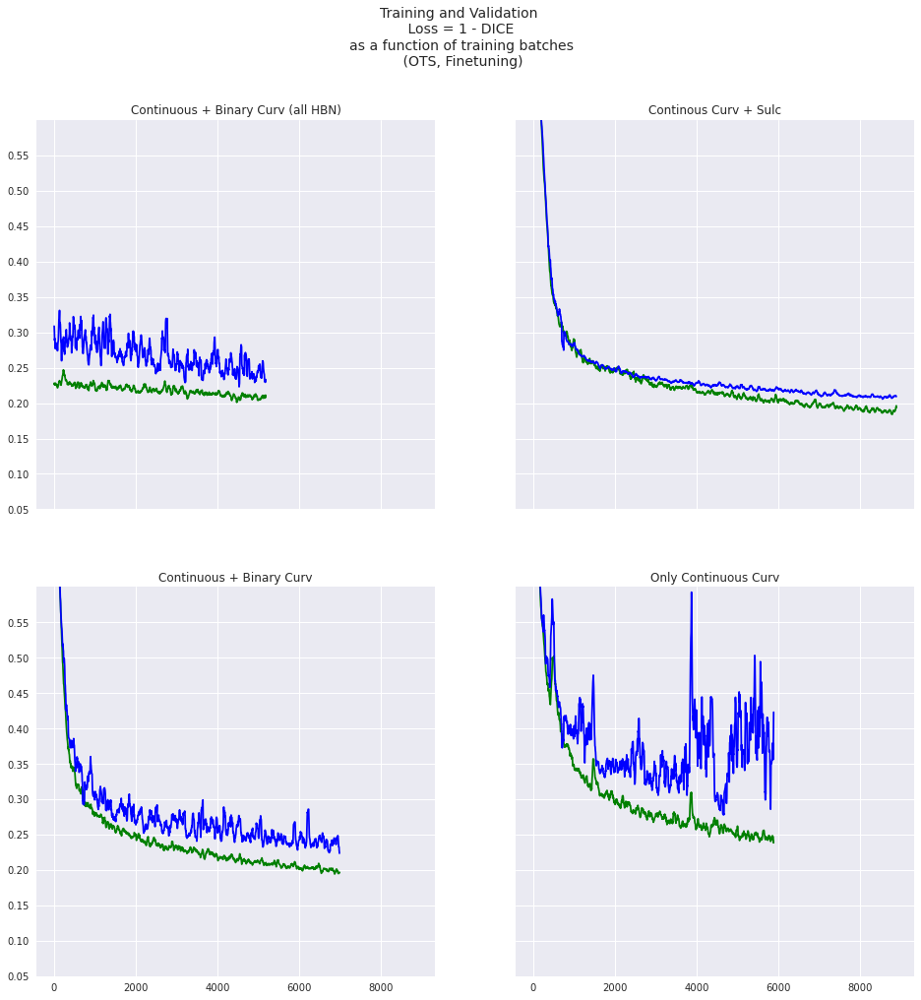

In [41]:
# make plot

fig, ax = plt.subplots(2, 2, figsize=(16, 16), sharex=True, sharey=True)
plt.style.use('seaborn')
bottom = 0.05
top = 0.6

ax[0, 0].plot(x_01_all, y1_01_all, color='green')
ax[0, 0].plot(x_01_all, y2_01_all, color='blue')
ax[0, 0].set_ylim(bottom, top)
ax[0, 0].set_yticks(np.arange(bottom, top, 0.05))
ax[0, 0].set_title('Continuous + Binary Curv (all HBN)')


ax[0, 1].plot(x_01, y1_01, color='green')
ax[0, 1].plot(x_01, y2_01, color='blue')
ax[0, 0].set_ylim(bottom, top)
ax[0, 0].set_yticks(np.arange(bottom, top, 0.05))
ax[0, 1].set_title('Continous Curv + Sulc')


ax[1, 0].plot(x_02, y1_02, color='green')
ax[1, 0].plot(x_02, y2_02, color='blue')
ax[0, 0].set_ylim(bottom, top)
ax[0, 0].set_yticks(np.arange(bottom, top, 0.05))
ax[1, 0].set_title('Continuous + Binary Curv')

ax[1, 1].plot(x_0, y1_0, color='green')
ax[1, 1].plot(x_0, y2_0, color='blue')
ax[0, 0].set_ylim(bottom, top)
ax[0, 0].set_yticks(np.arange(bottom, top, 0.05))
ax[1, 1].set_title('Only Continuous Curv')

plt.suptitle('Training and Validation \n Loss = 1 - DICE \nas a function of training batches' 
             '\n (OTS, Finetuning)', size='14')

plt.show()

In [105]:
device = dlutil.utils.get_device()
device

device(type='cuda', index=0)

In [26]:
save = False
load = False
if save:
    torch.save(model, model_fp)
if load:
    pretrained_params = torch.load(model_fp)

## 3.1 Visualize results on vertex mesh

### 3.1.1 Load pixel2vertex maps

In [189]:
os.listdir('./models')
model_dir = 'model_ots_mfs_gap_02_2022-11-24'
model_load_dir = f'models/{model_dir}'

In [36]:
reload_parameters = False
cpu = (device.type == 'cpu') 
device_string = 'cuda' if not cpu else 'cpu'  # in case model is saved from GPU but reloaded to CPU

if reload_parameters:
    
    # model_load_dir = './models/model_2022-10-12'
    # model_load_dir = model_save_dir
    model_state_fn, optim_state_fn = get_last_fns(model_load_dir)

    # reload model state dict
    with open(f'{model_load_dir}/{model_state_fn}', 'rb') as f:
        model_reload_dict = torch.load(f, map_location=torch.device(device_string))

    # reload optimizer state dict
    with open(f'{model_load_dir}/{optim_state_fn}', 'rb') as f:
        optim_reload_dict = torch.load(f, map_location=torch.device(device_string))
        
    model.load_state_dict(model_reload_dict)

In [203]:
reload_manual = True
if reload_manual:
    with open(f'{model_load_dir}/model000100.pkl', 'rb') as f:
        reload_dict = torch.load(f)
        
model.load_state_dict(reload_dict)

<All keys matched successfully>

In [15]:
from unet.pipeline_utilities import DESTRIEUX_FILENAME
import unet.pipeline_utilities as pu

In [16]:
from nilearn import surface, plotting

In [17]:
# data functions

def load_pickle(fp):
    """ Load single pickle file. 
    """
    import pickle
    with open(fp, 'rb') as f:
        p = pickle.load(f)
    return p


def load_numpy(fp):
    """ Load single numpy file. 
    """
    import numpy as np
    with open(fp, 'rb') as f:
        n = np.load(f)
    return n


def load_pickle_or_numpy_batch(fnames, 
                               prepend_fp=None, 
                               numpy=False):
    """ Load a series of pickle or saved numpy files
        into a list, and return the list.
    """
    import os
    
    if prepend_fp is not None:
        fps = [os.path.join(prepend_fp, n) for n in fnames]
    else:
        fps = fnames
        
    load = load_numpy if numpy else load_pickle

    return [load(fp) for fp in fps]


# vertex functions

def px2vx(px_np, px2vx_dict, vcoords, ignore=None):
    """ Translates an array of pixel-values to a statistical map
        that lives on a cortical surface, according to
        a supplied dictionary.
        Arguments:
            px_np: Array of pixel values of shape (xdim, ydim, ...)
            px2vx_dict: Dictionary whose keys are (i, j) pixel locations
                and whose values are lists of vertices corresponding
                to a given pixel in a given view of a cortex.
            vcoords: Coordinates of the cortical mesh
            ignore: Value not to include in arrays.
        Returns:
            The vmap (cortex) version of the supplied px_np array
            of pixel values.
    """
    vlen = vcoords.shape[0]
    vmap_shape = tuple([vlen] + list(px_np.shape[2:]))
    vmap = np.zeros(vmap_shape)
    n1 = px_np.shape[0]
    n2 = px_np.shape[1]
    for i in range(n1):
        for j in range(n2):
            v = px2vx_dict[(i, j)]
            if v != ignore:
                vmap[v] = px_np[i, j]
    return vmap


def make_mask_vmap(a, b, threshold_value=2.0, method=None):
    """ Make a mask (boolean) vmap based on which values
        are below an allowed maximum threshold of difference
        between pxcoords and vxcoords.
        Arguments:
            a, b: The two arrays to compare, of same shape
                (n_entries, n_coordinates). Distances are calculated
                on a sum over the coordinates (axis=1).
            threshold_value: the maximum theshold, a positive float
            method: how to calculate the distance to threshold,
                by default, absolute value. Can also be 'square'
                to calculate squared distance.
        Returns: a boolean array in the shape of a and b
    """
    fn = np.abs
    if method == 'square':
        fn = np.square
        
    diff_vmap = (fn(a - b)).sum(axis=1)
    mask_vmap = (diff_vmap > threshold_value)
    
    return mask_vmap


# analysis functions

def dice(target, prediction, target_label, pred_label=None):
    """ Calculates DICE by comparing target to prediction.
        'label' is the value of the label to compare.
    """
    if pred_label is None:
        pred_label = target_label
    lt = target == target_label
    lp = prediction == pred_label

    tp = sum(lt * lp)
    fp = sum(lp) - tp
    fn = sum(lt) - tp
    dice = (2 * tp) / (2 * tp + fp + fn)
    
    return dice

def average_dice(target, prediction, labels, return_all=False):
    dices = [dice(target, prediction, l) for l in labels]
    if return_all:
        return np.mean(dices), dices
    else:
        return np.mean(dices)

In [207]:
df_val = ds_val.xy_pairs
b = 0  # batch_number
df_batch = df_val.iloc[gp_ind[b]]

px2v_colname = 'Filename_v'
pcrd_colname = 'Filename_p'
px2v_fns = list(df_batch[px2v_colname])
pcrd_fns = list(df_batch[pcrd_colname])
eid = df_batch['EID'].iloc[0]

vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)

parc_subdir = 'parc'
surf_subdir = 'surf'
anat_data_dir = ots_dir

mesh_fn = 'lh.inflated'
parc_fn = f'{eid}-ots.npy'
curv_fn = 'lh.curv'

mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

mesh = surface.load_surf_mesh(mesh_fp)
parc = np.load(open(parc_fp, 'rb'))
parc = surface.load_surf_data(parc)
curv = surface.load_surf_data(curv_fp)

In [208]:
def aggregate_parc(parc):
    parc_copy = copy.deepcopy(parc)
    for k, v in ots_agg_dict.items():
        for val in v:
            parc_copy[parc_copy == val] = float(k)
    return parc_copy

hbn = False
ots = True

if hbn:
    parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)
    
if ots:
    parc = aggregate_parc(parc)

In [209]:
di_val_eid_batches = iter(dl_val_eid_batches)

In [210]:
mesh.coordinates.shape

(129665, 3)

In [211]:
# get data batches
for i in range(b + 1):
    xs, ys = next(di_val_eid_batches)

xs = xs.to(device)
ys_np = ys.detach().numpy()

# get model predictions
ypreds = model(xs)
ypreds_softmax = F.softmax(ypreds, dim=1)

# reshape predictions and move to numpy
ypreds_np = ypreds.cpu().detach().numpy()
ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

In [212]:
bsize = ys.shape[0]
pred_vmaps = []
prob_vmaps = []

for i in range(bsize):
    
    ypred_vmap = px2vx(ypreds_np_argmax[i], 
                       px2v_batch[i], 
                       mesh.coordinates)
    
    yprob_vmap = px2vx(ypreds_softmax_np[i], 
                       px2v_batch[i], 
                       mesh.coordinates)

    vcrd_vmap = px2vx(vcrd_batch[i],
                      px2v_batch[i],
                      mesh.coordinates)

    mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)
    
    ypred_masked_vmap = ypred_vmap[:]
    ypred_masked_vmap[mask] = 0.0
    
    yprob_masked_vmap = yprob_vmap[:]
    yprob_masked_vmap[mask] = 0.0
    
    pred_vmaps.append(ypred_masked_vmap)
    prob_vmaps.append(yprob_masked_vmap)

pred_vmaps = np.stack(pred_vmaps)
prob_vmaps = np.stack(prob_vmaps)

In [213]:
nclasses = 5
classes = list(range(nclasses))
class_sums = []

for c in classes:
    class_sums.append(np.sum(pred_vmaps == c, axis=0))

class_sums = np.stack(class_sums)

threshold = 12
ensemble_prediction = np.zeros_like(class_sums)
ensemble_prediction[class_sums >= threshold] = 1.0

class_prob_sums = prob_vmaps.sum(axis=0)
class_prob_sums.shape

(129665, 5)

In [226]:
# ensemble of probabilities (summed over all views)
c = 2
y_view = plotting.view_surf(mesh, class_prob_sums[:, 2], bg_map=curv, cmap='viridis', threshold=15.0, symmetric_cmap=False)
y_view

In [215]:
# ensemble method not based on probabilities
c = 2
y_view = plotting.view_surf(mesh, ensemble_prediction[3], bg_map=curv, cmap='tab20', threshold=0.5)
y_view

In [221]:
g_view = plotting.view_surf(mesh, parc == 2, bg_map=curv, cmap='tab10', threshold=0.5, symmetric_cmap=False)
g_view

In [222]:
np.unique(parc, return_counts=True)

(array([1., 2., 3.]), array([127875,   1626,    164]))

In [223]:
dice(parc, ensemble_prediction[2], target_label=2.0, pred_label=1.0)

0.572463768115942

In [225]:
diff = class_prob_sums[2] - 2 * (parc == 2)

ValueError: operands could not be broadcast together with shapes (5,) (129665,) 

In [224]:
d_view = plotting.view_surf(mesh, diff, bg_map=curv, cmap='tab10', threshold=0.5)
d_view

NameError: name 'diff' is not defined

In [50]:
d_view.save_as_html('difference_map_3d_ots_multiple_unfrozen_layers.html')

## 3.2 Calculate DICE

In [228]:
def load_subject_data_for_prediction(eid, 
                                     data_type='ots', 
                                     anat_dir=None, 
                                     base_data_dir=None
                                    ):
    """
        Load subject anatomical data for use in multi-view prediction.
        Different logic for different sources of data.
        Arguments:
            eid: (str) subject identifier
            data_type: (string, optional) 'hbn' or 'ots'
            anat_dir: (string, optional) base directory in which
                to find freesurfer derivatives, e.g. ./surf, etc.
        Returns:
            a dictionary with keys, values:
                'mesh': desired cortical mesh
                'curv': curvature stat map adapted to the above mesh
                'parc': processed parcelation, either a subselection
                    of Destrieux labels if data_type='hbn', otherwise
                    a retrieved manual parcellation from a different
                    directory if data_type='ots'
    
    """
    from unet.pipeline_utilities import DESTRIEUX_FILENAME
    from unet.pipeline_utilities import get_filtered_parc
    
    mesh_fn = 'lh.inflated'
    parc_fn = DESTRIEUX_FILENAME
    curv_fn = 'lh.curv'

    # different loading logic depending on data source (hbn vs. ots)
    # logic for hbn
    if data_type == 'hbn':
        
        if anat_dir is None:
            
            anat_dir = '/oak/stanford/groups/jyeatman/HBN/BIDS_curated/derivatives/freesurfer'
        
        surf_dir = 'surf'
        parc_dir = 'label'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        # parse out parcellation
        parc_selected = get_filtered_parc(parc, fill_value=0.0)

    # logic for ots
    elif data_type == 'ots':
        
        if base_data_dir is None:
            base_data_dir = '/scratch/groups/jyeatman/samjohns-projects/data/atlas/ots-sulc'

        parc_subdir = 'parc'
        surf_subdir = 'surf'
        anat_data_dir = '/oak/stanford/groups/jyeatman/samjohns/samjohns-projects-backup/ots-data'

        mesh_fn = 'lh.inflated'
        parc_fn = f'{eid}-ots.npy'
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
        parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
        curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = np.load(open(parc_fp, 'rb'))
        parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
        curv = surface.load_surf_data(curv_fp)

        # parse out parcellation
        parc_selected = aggregate_parc(parc)
    
    else:
        raise NotImplementedError('Data type provided is not supported.')
    
    return {'mesh': mesh, 
            'curv': curv, 
            'parc': parc_selected
           }

In [237]:
preds_from_file = False  # whether to load nn predictions from saved files
overwrite_saved_sums = False
enforce_batch_size = False
hbn = False

nbatches = len(gp_ind)
batch_size = 40
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, 15, 2))
class_range = list(range(3, 21)) if hbn else list(range(3))

In [238]:
result_dir = f'./results/ots_{date}'
os.makedirs(result_dir, exist_ok=True)

In [239]:
threshold_dice_dict = {}
for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if enforce_batch_size and (batch < batch_size):
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        # different loading logic depending on data source (hbn vs. ots)
        # logic for hbn
        if hbn: 
            
            mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
            parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
            curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = surface.load_surf_data(parc_fp)
            curv = surface.load_surf_data(curv_fp)
            
            # parse out parcellation
            parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        # logic for ots
        else:
            
            parc_subdir = 'parc'
            surf_subdir = 'surf'
            anat_data_dir = ots_dir
            
            mesh_fn = 'lh.inflated'
            parc_fn = f'{eid}-ots.npy'
            curv_fn = 'lh.curv'

            mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
            parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
            curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = np.load(open(parc_fp, 'rb'))
            parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
            curv = surface.load_surf_data(curv_fp)
        
            # parse out parcellation
            parc_selected = aggregate_parc(parc)

        xs = xs.to(device)
        ys_np = ys.detach().numpy()

        # get model predictions, either from previously saved files
        # or by applying the trained model to the current batch
        if preds_from_file:
            with open(f'pred_dict_{batch}.pkl', 'rb') as f:
                pred_dict = pickle.load(f)
            ypreds = torch.Tensor(pred_dict['yhat'])
        else:
            ypreds = model(xs)
        
        ypreds_softmax = F.softmax(ypreds, dim=1)

        # reshape predictions and move to numpy
        ypreds_np = ypreds.cpu().detach().numpy()
        ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
        ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
        ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

        # skip current loop unless there are batch_size examples in batch
        if enforce_batch_size and (ys.shape[0] != batch_size):  
            continue
        
        sampled_batch_size = ys.shape[0]
            
        pred_vmaps = []
        prob_vmaps = []

        for i in range(sampled_batch_size):

            ypred_vmap = px2vx(ypreds_np_argmax[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            yprob_vmap = px2vx(ypreds_softmax_np[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            vcrd_vmap = px2vx(vcrd_batch[i],
                              px2v_batch[i],
                              mesh.coordinates)

            mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)

            ypred_masked_vmap = ypred_vmap[:]
            ypred_masked_vmap[mask] = 0.0

            yprob_masked_vmap = yprob_vmap[:]
            yprob_masked_vmap[mask] = 0.0

            pred_vmaps.append(ypred_masked_vmap)
            prob_vmaps.append(yprob_masked_vmap)

        pred_vmaps = np.stack(pred_vmaps)
        prob_vmaps = np.stack(prob_vmaps)
        prob_sums = prob_vmaps.sum(axis=0)

        if hbn:
            
            nclasses = 21
            classes = list(range(nclasses))
        
        else:
            classes = class_range
        
        class_sums = []

        for c in classes:
            class_sums.append(np.sum(pred_vmaps == c, axis=0))

        class_sums = np.stack(class_sums)
        class_sum_fn = f'{result_dir}/ots_class_sums_{eid}.npy'
        prob_sum_fn = f'{result_dir}/ots_prob_sums_{eid}.npy'
        
        with open(prob_sum_fn, 'wb') as f:
            np.save(f, prob_sums)
        
        if (not os.path.exists(class_sum_fn)) or overwrite_saved_sums:
            with open(class_sum_fn, 'wb') as f:
                np.save(f, class_sums)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        grnd = parc_selected
        yhat = ensemble_prediction[c]

        dices_by_class = []
        
        if hbn:
            class_range = list(range(3, 21))
        
        for c in class_range:

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=c, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'{result_dir}/ots_threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [251]:
load_class_sums = True
load_prob_sums = True
threshold_dice_dict = {}
thresholds = list(range(1, 11))

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if enforce_batch_size and (batch < batch_size):
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        # different loading logic depending on data source (hbn vs. ots)
        # logic for hbn
        if hbn: 
            
            mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
            parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
            curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = surface.load_surf_data(parc_fp)
            curv = surface.load_surf_data(curv_fp)
            
            # parse out parcellation
            parc = pu.get_filtered_parc(parc, fill_value=0.0)

        # logic for ots
        else:
            
            parc_subdir = 'parc'
            surf_subdir = 'surf'
            anat_data_dir = ots_dir
            
            mesh_fn = 'lh.inflated'
            parc_fn = f'{eid}-ots.npy'
            curv_fn = 'lh.curv'

            mesh_fp = os.path.join(anat_data_dir, eid, surf_subdir, mesh_fn)
            parc_fp = os.path.join(base_data_dir, parc_subdir, parc_fn)
            curv_fp = os.path.join(anat_data_dir, eid, surf_subdir, curv_fn)

            mesh = surface.load_surf_mesh(mesh_fp)
            parc = np.load(open(parc_fp, 'rb'))
            parc = surface.load_surf_data(parc)  # TODO: Is this line redundant?
            curv = surface.load_surf_data(curv_fp)
        
        class_sum_fn = f'{result_dir}/ots_class_sums_{eid}.npy'
        prob_sum_fn = f'{result_dir}/ots_prob_sums_{eid}.npy'
        
        if load_class_sums:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f)
                
        if load_prob_sums:
            with open(class_sum_fn, 'rb') as f:
                prob_sums = np.load(f)
            
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        prob_prediction = np.zeros_like(prob_sums)
        prob_prediction[prob_sums >= threshold] = 1.0
        
        dices_by_class = []
        
        if hbn:
            class_range = list(range(3, 21))
        
        for c in class_range:

            grnd = aggregate_parc(parc)
            # yhat = ensemble_prediction[c]
            yhat = prob_prediction[c]
            d = dice(grnd, yhat, target_label=c, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'{result_dir}/ots_prob_threshold_low_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [252]:
mean_dices = []
for i, d in threshold_dice_dict.items():
    md = np.mean(d, axis=0)[2]
    mean_dices.append(md)

In [253]:
thresholds = list(threshold_dice_dict.keys())

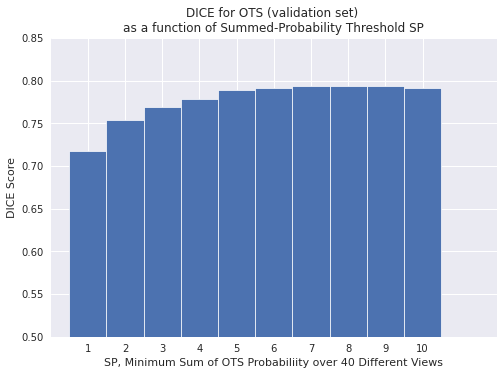

In [259]:
x, y = thresholds, mean_dices

plt.style.use('seaborn')
fig, ax = plt.subplots()

ax.bar(x, y, width=1, edgecolor="white", linewidth=0.7)
ax.set(xlim=(0, 12), xticks=np.arange(1, 11),
       ylim=(0.5, 0.7), yticks=np.arange(0.5, 0.9, 0.05))

plt.title('DICE for OTS (validation set) \n'
          'as a function of Summed-Probability Threshold SP')
plt.xlabel('SP, Minimum Sum of OTS Probabiliity over 40 Different Views')
plt.ylabel('DICE Score')
plt.show()


In [ ]:
# for calculating DICE from saved vmap files
# in this case, class_sums (# of positive predictions per class)

load_vmaps = False  # whether to load nn predictions from saved files
save_dice_dict = False # whether to save predictions

z_mask = True
z_mask_threshold = 0.0

ots = True
hbn = False

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, min([len(x) for x in gp_ind])))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch in range(len(gp_ind)):  # loop over batches

        df_batch = df_val.iloc[gp_ind[batch]]
        if enforce_batch_size and len(df_batch) != batch_size:
            continue

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        dt = 'hbn' if hbn else 'ots'
        load_dict = load_subject_data_for_prediction(eid, data_type=dt)
        mesh = load_dict['mesh']
        curv = load_dict['curv']
        parc = load_dict['parc']

        class_sum_fn = f'ots_class_sums_{eid}.npy'
        
        # load previously computed class counts from file
        if os.path.exists(class_sum_fn) and load_vmaps:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f, allow_pickle=True)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        if z_mask:

            ensemble_prediction[:, mesh.coordinates[:, 2] > z_mask_threshold] = 0.0

        dices_by_class = []
        for c in class_range:

            grnd = parc
            yhat = ensemble_prediction[c]
            tlab = c - 2 if hbn else c
            
            d = dice(grnd, yhat, target_label=tlab, pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'ots-zmask-threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [65]:
preds_from_file = False  # whether to load nn predictions from saved files
overwrite_saved_sums = True

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(1, 10, 2))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch, (xs, ys) in enumerate(di_val_eid_batches):  # loop over batches
        
        if batch < 42:
            continue

        df_batch = df_val.iloc[gp_ind[batch]]

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        xs = xs.to(device)
        ys_np = ys.detach().numpy()

        # get model predictions, either from previously saved files
        # or by applying the trained model to the current batch
        if preds_from_file:
            with open(f'pred_dict_{batch}.pkl', 'rb') as f:
                pred_dict = pickle.load(f)
            ypreds = torch.Tensor(pred_dict['yhat'])
        else:
            ypreds = model(xs)
        
        ypreds_softmax = F.softmax(ypreds, dim=1)

        # reshape predictions and move to numpy
        ypreds_np = ypreds.cpu().detach().numpy()
        ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
        ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
        ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

        if ys.shape[0] != batch_size:  # skip current loop unless there are 48 examples in batch
            continue
            
        pred_vmaps = []
        prob_vmaps = []

        for i in range(batch_size):

            ypred_vmap = px2vx(ypreds_np_argmax[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            yprob_vmap = px2vx(ypreds_softmax_np[i], 
                               px2v_batch[i], 
                               mesh.coordinates)

            vcrd_vmap = px2vx(vcrd_batch[i],
                              px2v_batch[i],
                              mesh.coordinates)

            mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)

            ypred_masked_vmap = ypred_vmap[:]
            ypred_masked_vmap[mask] = 0.0

            yprob_masked_vmap = yprob_vmap[:]
            yprob_masked_vmap[mask] = 0.0

            pred_vmaps.append(ypred_masked_vmap)
            prob_vmaps.append(yprob_masked_vmap)

        pred_vmaps = np.stack(pred_vmaps)
        prob_vmaps = np.stack(prob_vmaps)

        nclasses = 21
        classes = list(range(nclasses))
        class_sums = []

        for c in classes:
            class_sums.append(np.sum(pred_vmaps == c, axis=0))

        class_sums = np.stack(class_sums)
        class_sum_fn = f'class_sums_{eid}.npy'
        if (not os.path.exists(class_sum_fn)) or overwrite_saved_sums:
            with open(class_sum_fn, 'wb') as f:
                np.save(f, class_sums)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0
        
        grnd = parc_selected
        yhat = ensemble_prediction[c]

        dices_by_class = []
        for c in range(3, 21):

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=(c-2), pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

NameError: name 'threshold_dice_dict' is not defined

In [ ]:
# for calculating DICE from saved vmap files
# in this case, class_sums (# of positive predictions per class)

load_vmaps = True  # whether to load nn predictions from saved files

nbatches = len(gp_ind)
batch_size = 48
# thresholds = list(range(1, batch_size))
thresholds = list(range(11, 48, 2))
threshold_dice_dict = {}

for threshold in thresholds:  # loop over different aggregation schemes
    
    threshold_dices = []
    di_val_eid_batches = iter(dl_val_eid_batches)  # restart iterator
    
    for batch in range(1, len(gp_ind)):  # loop over batches

        df_batch = df_val.iloc[gp_ind[batch]]
        if len(df_batch) != batch_size:
            continue

        # load px2v data to translate from pixel to cortex mesh
        px2v_colname = 'Filename_v'
        pcrd_colname = 'Filename_p'
        px2v_fns = list(df_batch[px2v_colname])
        pcrd_fns = list(df_batch[pcrd_colname])
        eid = df_batch['EID'].iloc[0]

        vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
        px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)
        
        # load freesurfer data
        mesh_fn = 'lh.inflated'
        parc_fn = DESTRIEUX_FILENAME
        curv_fn = 'lh.curv'

        mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)
        curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)

        mesh = surface.load_surf_mesh(mesh_fp)
        parc = surface.load_surf_data(parc_fp)
        curv = surface.load_surf_data(curv_fp)

        parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)

        nclasses = 21
        classes = list(range(nclasses))

        class_sum_fn = f'class_sums_{eid}.npy'
        
        # load previously computed class counts from file
        if os.path.exists(class_sum_fn) and load_vmaps:
            with open(class_sum_fn, 'rb') as f:
                class_sums = np.load(f, allow_pickle=True)
        
        ensemble_prediction = np.zeros_like(class_sums)
        ensemble_prediction[class_sums >= threshold] = 1.0

        dices_by_class = []
        for c in range(3, 21):

            grnd = parc_selected
            yhat = ensemble_prediction[c]
            d = dice(grnd, yhat, target_label=(c-2), pred_label=1.0)
            dices_by_class.append(d)
        
        threshold_dices.append(dices_by_class)
        
        del mesh
        del parc
        del curv
        
    threshold_dice_dict[threshold] = threshold_dices
    with open(f'threshold_dice_dict_{threshold}.pkl', 'wb') as f:
        pickle.dump(threshold_dice_dict, f)

In [18]:
dice_fns = [fn for fn in os.listdir() if 'threshold' in fn]

# load saved dice dictionaries
dices = []
for dice_fn in dice_fns:
    with open(dice_fn, 'rb') as f:
        dice_dict = pickle.load(f)
        dices.append(dice_dict)

In [36]:
dice_summaries_dict = {}
for d_dict in dices:
    
    k = max(d_dict.keys())
    d_list = d_dict[k]
    
    d_np = np.array(d_list)
    d_sums = d_np.mean(axis=0)
    d_stes = d_np.std(axis=0)/(d_np.shape[0])
    
    dice_summaries_entry = {'mean': d_sums, 'ste': d_stes}
    dice_summaries_dict[k] = dice_summaries_entry

In [38]:
dice_summaries_dict.keys()

dict_keys([1, 3, 7, 5, 9, 11])

In [43]:
n_classes = dice_summaries_dict[11]['mean'].shape[0]


In [44]:
n_classes

18

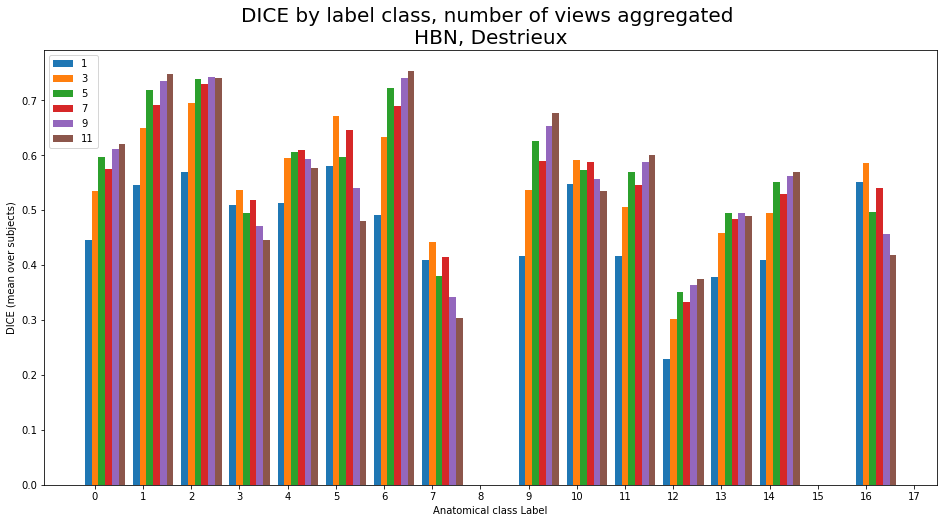

In [106]:
# bar graph
fig, ax = plt.subplots(figsize=(16, 8))
x = np.arange(n_classes)
y1 = dice_summaries_dict[1]['mean']
y2 = dice_summaries_dict[11]['mean']
ys = [dice_summaries_dict[i]['mean'] for i in dice_summaries_dict.keys()]
# ys = [y1, y2]
width = 0.14
for i, y in enumerate(ys):
    ax.bar(x + i * width, y, width, 
           color=list(plt.rcParams['axes.prop_cycle'])[i]['color'])
    ax.set_xticks(x + width)
    ax.set_xticklabels(x)
    ax.legend([2*i + 1 for i in x])
ax.set_title('DICE by label class, number of views aggregated \n'
             'HBN, Destrieux', size=20.0)
ax.set_xlabel('Anatomical class Label')
ax.set_ylabel('DICE (mean over subjects)')
plt.show()

In [75]:
ys_means = []
ys_stds = []
for y in ys:
    y_zero_nan = y[:]
    y_zero_nan[y_zero_nan == 0.0] = np.nan
    ys_means.append(np.nanmean(y_zero_nan))
    ys_stds.append(np.nanstd(y_zero_nan))

In [99]:
ys_stes = [s/np.sqrt(92) for s in ys_stds]

In [100]:
ys_means, ys_stes

([0.43829632288059306,
  0.5488690054484466,
  0.5678502118254499,
  0.565692024652973,
  0.5636375231156181,
  0.5557907204674742],
 [0.014945324818217988,
  0.01025192124663677,
  0.011428531526163334,
  0.010634217263519381,
  0.012606257756716657,
  0.0139932367179717])

Text(0, 0.5, 'DICE (averaged over classes)')

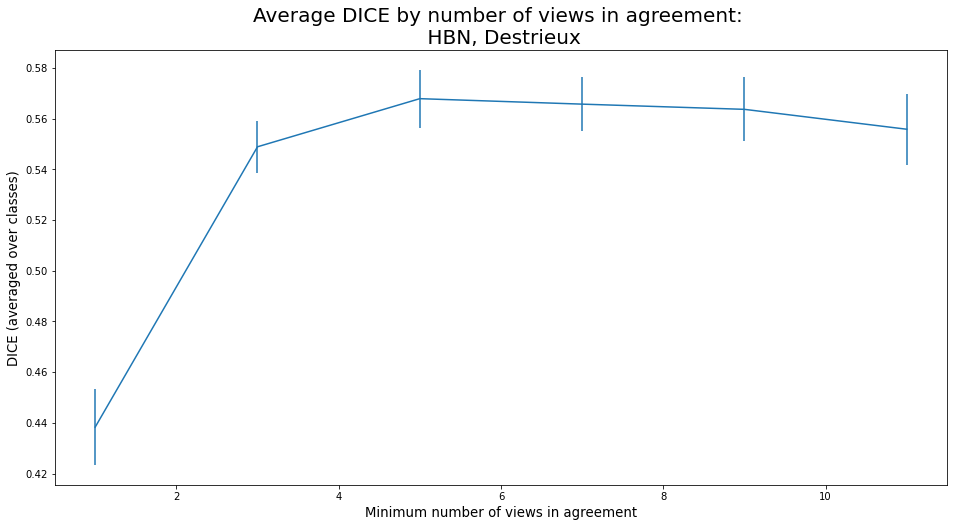

In [107]:
fig, ax = plt.subplots(figsize=(16, 8))
text_size = 20.0
ax.errorbar(list(range(1, 12, 2)), ys_means, yerr=ys_stes)
ax.set_title('Average DICE by number of views in agreement: \n HBN, Destrieux', size=text_size)
ax.set_xlabel('Minimum number of views in agreement', size=text_size/1.5)
ax.set_ylabel('DICE (averaged over classes)', size=text_size/1.5)

# 4. Apply to HBN

In [15]:
# load trained model params
model_save_dir = 'models/model_ots_mfs_gap_02_2022-11-24'
model_fp = f'{model_save_dir}/model000100.pkl'  # specific choice of best model
pretrained_params = torch.load(model_fp)

# define model
device = dlutil.utils.get_device()

in_channels = 3
out_channels = 5
model = unet.UNet(feature_count=in_channels, class_count=out_channels, apply_sigmoid=False)
model.to(device)
model.load_state_dict(pretrained_params)
model.eval()

RuntimeError: Attempting to deserialize object on a CUDA device but torch.cuda.is_available() is False. If you are running on a CPU-only machine, please use torch.load with map_location=torch.device('cpu') to map your storages to the CPU.

In [18]:
gp_ind = get_index_batches(df_val, group_name='EID')
df_trn = ds_trn.xy_pairs
gp_trn_ind = get_index_batches(df_trn, group_name='EID')

In [27]:
pred_save_dir = f'results/hbn_ots_{date}'
os.makedirs(pred_save_dir, exist_ok=True)
pred_save_dir

'results/hbn_ots_2022-11-27'

In [22]:
torch.cuda.empty_cache()

In [24]:
len(gp_ind), len(gp_trn_ind)

(229, 2063)

In [31]:
len(set(df_val['EID'].unique())), len(set(df_trn['EID'].unique()))

(229, 2063)

In [ ]:
# loop over data and save results
split_size = 35  # extra logic for 

di_trn_eid = iter(dl_trn_eid_batches)
di_val_eid = iter(dl_val_eid_batches)
di_dicts = [
    {'di' : di_trn_eid, 'df' : df_trn, 'ix' : gp_trn_ind},
    {'di' : di_val_eid, 'df' : df_val, 'ix' : gp_ind}
]

for batch, (xs, ys) in enumerate(di_trn_eid):
    df = df_trn.iloc[gp_trn_ind[batch]]
    eid = str(df.iloc[0]['EID'])
    
    x1 = xs[:split_size]
    oversized = xs.shape[0] > split_size
    pred1 = model(x1.to(device))
    pred1 = pred1.cpu().detach().numpy()
    
    if oversized:
        x2 = xs[split_size:]
        pred2 = model(x2.to(device))
        pred2 = pred2.cpu().detach().numpy()
        pred = np.concatenate([pred1, pred2])       
    else:
        pred = pred1
        
    save_pred_fn = f'{pred_save_dir}/pred_02_{eid}.npy'
    with open(save_pred_fn, 'wb') as f:
        np.save(f, pred)
    print(f'Saved eid: {eid}')

    del xs
    del ys
    del pred1
    if oversized:
        del pred2
    del pred

Saved eid: sub-NDARAA075AMK
Saved eid: sub-NDARAA306NT2
Saved eid: sub-NDARAA504CRN
Saved eid: sub-NDARAA536PTU
Saved eid: sub-NDARAA947ZG5
Saved eid: sub-NDARAA948VFH
Saved eid: sub-NDARAB348EWR
Saved eid: sub-NDARAB458VK9
Saved eid: sub-NDARAB514MAJ
Saved eid: sub-NDARAB756JDJ
Saved eid: sub-NDARAC349YUC
Saved eid: sub-NDARAC350XUM
Saved eid: sub-NDARAC462DZH
Saved eid: sub-NDARAC495TJ2
Saved eid: sub-NDARAC853CR6
Saved eid: sub-NDARAC857HDB
Saved eid: sub-NDARAC904DMU
Saved eid: sub-NDARAD224CRB
Saved eid: sub-NDARAD232HVV
Saved eid: sub-NDARAD481FXF
Saved eid: sub-NDARAD571FLB
Saved eid: sub-NDARAD615WLJ
Saved eid: sub-NDARAD703XA2
Saved eid: sub-NDARAE012DGA
Saved eid: sub-NDARAE199TDD
Saved eid: sub-NDARAE358VBE
Saved eid: sub-NDARAE877NER
Saved eid: sub-NDARAF440XWG
Saved eid: sub-NDARAF535XK6
Saved eid: sub-NDARAG115LZP
Saved eid: sub-NDARAG191AE8
Saved eid: sub-NDARAG340ERT
Saved eid: sub-NDARAG610XL4
Saved eid: sub-NDARAH304ED7
Saved eid: sub-NDARAH503YG1
Saved eid: sub-NDARA

Saved eid: sub-NDARDN489EXJ
Saved eid: sub-NDARDN702GXX
Saved eid: sub-NDARDN996CPF
Saved eid: sub-NDARDP495PY2
Saved eid: sub-NDARDP725ZVY
Saved eid: sub-NDARDP786HE6
Saved eid: sub-NDARDR067YMC
Saved eid: sub-NDARDR236FWH
Saved eid: sub-NDARDR304HHJ
Saved eid: sub-NDARDR439HY2
Saved eid: sub-NDARDR458MR7
Saved eid: sub-NDARDR591AUC
Saved eid: sub-NDARDR595ZE5
Saved eid: sub-NDARDT499DWP
Saved eid: sub-NDARDT528ZZJ
Saved eid: sub-NDARDT550XYX
Saved eid: sub-NDARDU602LPX
Saved eid: sub-NDARDU799BZF
Saved eid: sub-NDARDU853XZ6
Saved eid: sub-NDARDU986RBM
Saved eid: sub-NDARDV204BYM
Saved eid: sub-NDARDV245WJG
Saved eid: sub-NDARDW178AC6
Saved eid: sub-NDARDW416KWZ
Saved eid: sub-NDARDW711NYZ
Saved eid: sub-NDARDX173WLD
Saved eid: sub-NDARDX196MZP
Saved eid: sub-NDARDX433HXA
Saved eid: sub-NDARDX469TC1
Saved eid: sub-NDARDX561MRY
Saved eid: sub-NDARDX665TKP
Saved eid: sub-NDARDX770PJK
Saved eid: sub-NDARDX872VH6
Saved eid: sub-NDARDX910VTC
Saved eid: sub-NDARDY150ZP9
Saved eid: sub-NDARD

Saved eid: sub-NDARGP984YLN
Saved eid: sub-NDARGR125APK
Saved eid: sub-NDARGR354WBH
Saved eid: sub-NDARGR661YZG
Saved eid: sub-NDARGR893PUA
Saved eid: sub-NDARGT022BEW
Saved eid: sub-NDARGT267UZR
Saved eid: sub-NDARGT682ZWN
Saved eid: sub-NDARGU067HT7
Saved eid: sub-NDARGU100JH4
Saved eid: sub-NDARGU395RFP
Saved eid: sub-NDARGU461JX2
Saved eid: sub-NDARGU485JJA
Saved eid: sub-NDARGU667MCK
Saved eid: sub-NDARGU729WUR
Saved eid: sub-NDARGU829GZ4
Saved eid: sub-NDARGU844NZ3
Saved eid: sub-NDARGV220AU1
Saved eid: sub-NDARGV948BFZ
Saved eid: sub-NDARGW404GJL
Saved eid: sub-NDARGW450YUX
Saved eid: sub-NDARGX161LRM
Saved eid: sub-NDARGX443CEU
Saved eid: sub-NDARGX760NYV
Saved eid: sub-NDARGY148EVU
Saved eid: sub-NDARGY542TJ5
Saved eid: sub-NDARGY622NG6
Saved eid: sub-NDARGY639ANB
Saved eid: sub-NDARGY959RN8
Saved eid: sub-NDARGZ207NNA
Saved eid: sub-NDARHA387FPM
Saved eid: sub-NDARHB261JMG
Saved eid: sub-NDARHB689WH7
Saved eid: sub-NDARHB764VZ2
Saved eid: sub-NDARHB781DD8
Saved eid: sub-NDARH

Saved eid: sub-NDARKN477EBH
Saved eid: sub-NDARKN509RP9
Saved eid: sub-NDARKN520GGD
Saved eid: sub-NDARKN633WZA
Saved eid: sub-NDARKN742LEV
Saved eid: sub-NDARKN848XH8
Saved eid: sub-NDARKN988BRP
Saved eid: sub-NDARKP053GCC
Saved eid: sub-NDARKP414AZ5
Saved eid: sub-NDARKP815KPZ
Saved eid: sub-NDARKP893TWU
Saved eid: sub-NDARKR010EN7
Saved eid: sub-NDARKR155ME9
Saved eid: sub-NDARKR195PL9
Saved eid: sub-NDARKR391CMV
Saved eid: sub-NDARKT312RUD
Saved eid: sub-NDARKT540ZW0
Saved eid: sub-NDARKT714TXR
Saved eid: sub-NDARKT811ATJ
Saved eid: sub-NDARKU616UBL
Saved eid: sub-NDARKU726AB4
Saved eid: sub-NDARKV353MTD
Saved eid: sub-NDARKV461KGZ
Saved eid: sub-NDARKV482FU9
Saved eid: sub-NDARKV800DTW
Saved eid: sub-NDARKV807EMJ
Saved eid: sub-NDARKV965WLU
Saved eid: sub-NDARKW010CT2
Saved eid: sub-NDARKW521EMY
Saved eid: sub-NDARKW531ACR
Saved eid: sub-NDARKW565ZT9
Saved eid: sub-NDARKW738AMY
Saved eid: sub-NDARKW999WZD
Saved eid: sub-NDARKX346VTV
Saved eid: sub-NDARKX528PH3
Saved eid: sub-NDARK

In [19]:
def batch_px2v(
    df, 
    ind, 
    batch, 
    load_dir,
    save_dir=None,
    load_parc=False, 
    preds_from_file=True
):

    df_batch = df.iloc[ind[batch]]

    # collect batch metadata from df
    px2v_colname = 'Filename_v'
    pcrd_colname = 'Filename_p'
    px2v_fns = list(df_batch[px2v_colname])
    pcrd_fns = list(df_batch[pcrd_colname])
    eid = str(df_batch['EID'].iloc[0])
    
    # load px2v maps
    vcrd_batch = load_pickle_or_numpy_batch(pcrd_fns, pdir, numpy=True)
    px2v_batch = load_pickle_or_numpy_batch(px2v_fns, vdir)

    # load freesurfer data
    mesh_fn = 'lh.inflated'
    curv_fn = 'lh.curv'
    
    mesh_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, mesh_fn)
    curv_fp = os.path.join(hbn_dir, eid, hbn_surf_dir, curv_fn)
    
    mesh = surface.load_surf_mesh(mesh_fp)
    curv = surface.load_surf_data(curv_fp)
    
    # optional extra data for loading parc, if desired
    if load_parc:
        
        parc_fn = DESTRIEUX_FILENAME
        parc_fp = os.path.join(hbn_dir, eid, hbn_parc_dir, parc_fn)

        parc = surface.load_surf_data(parc_fp)
        parc_selected = pu.get_filtered_parc(parc, fill_value=0.0)
        
    if preds_from_file:
        with open(f'{load_dir}/pred_02_{eid}.npy', 'rb') as f:
            preds = np.load(f)
    else:
        raise NotImplemented
        
    ypreds = torch.Tensor(preds)
    ypreds_softmax = F.softmax(ypreds, dim=1)

    # reshape predictions and move to numpy
    ypreds_np = ypreds.cpu().detach().numpy()
    ypreds_softmax_np = ypreds_softmax.cpu().detach().numpy()
    ypreds_softmax_np = np.transpose(ypreds_softmax_np, axes=(0, 2, 3, 1))  # place channel dim last
    ypreds_np_argmax = np.argmax(ypreds_np, axis=1)  # eliminate channel dim by taking max

    pred_vmaps = []
    prob_vmaps = []

    for i in range(preds.shape[0]):

        ypred_vmap = px2vx(ypreds_np_argmax[i], 
                           px2v_batch[i], 
                           mesh.coordinates)

        yprob_vmap = px2vx(ypreds_softmax_np[i], 
                           px2v_batch[i], 
                           mesh.coordinates)

        vcrd_vmap = px2vx(vcrd_batch[i],
                          px2v_batch[i],
                          mesh.coordinates)

        # mask out any dorsal predictions
        mask = make_mask_vmap(vcrd_vmap, mesh.coordinates)

        ypred_masked_vmap = ypred_vmap[:]
        ypred_masked_vmap[mask] = 0.0

        yprob_masked_vmap = yprob_vmap[:]
        yprob_masked_vmap[mask] = 0.0

        pred_vmaps.append(ypred_masked_vmap)
        prob_vmaps.append(yprob_masked_vmap)

    pred_vmaps = np.stack(pred_vmaps)
    prob_vmaps = np.stack(prob_vmaps)
    
    # save
    if save_dir is not None:
        
        save_pred_vmap_fn = f'vmap_pred_{eid}.npy'
        save_prob_vmap_fn = f'vmap_prob_{eid}.npy'

        with open(f'{save_dir}/{save_pred_vmap_fn}', 'wb') as f:
            np.save(f, pred_vmaps)
        with open(f'{save_dir}/{save_prob_vmap_fn}', 'wb') as f:
            np.save(f, prob_vmaps)
    
    # make class sums
    nclasses = 5
    classes = list(range(nclasses))
    class_sums = []
    for c in classes:
        class_sums.append(np.sum(pred_vmaps == c, axis=0))

    class_sums = np.stack(class_sums)
    
    if save_dir is not None:
        
        class_sum_fn = f'class_sums_{eid}.npy'
        with open(f'{save_dir}/{class_sum_fn}', 'wb') as f:
            np.save(f, class_sums)
    
    ret_dict = {}
    ret_dict['mesh'] = mesh
    ret_dict['curv'] = curv
    ret_dict['pred'] = pred_vmaps
    ret_dict['prob'] = prob_vmaps
    ret_dict['df'] = df_batch
    
    return ret_dict

In [20]:
load_dir = 'results/hbn_ots_2022-11-27'
save_dir = f'results/hbn_ots_vmaps_{date}'
os.makedirs(save_dir, exist_ok=True)

In [55]:
returns = batch_px2v(
    df_val, 
    gp_ind, 
    batch=1, 
    load_dir=load_dir,
    load_parc=False, 
    preds_from_file=True
)

In [65]:
len(gp_ind), len(gp_trn_ind)

(229, 2063)

In [22]:
save_dir = 'results/hbn_ots_vmaps_2022-11-27'

In [30]:
run_all_trn = True
# start_ind = 0
start_ind = 2050
if run_all_trn:
    
    for b in range(start_ind, len(gp_trn_ind)):
        _ = batch_px2v(
            df_trn, 
            gp_trn_ind, 
            batch=b, 
            save_dir=save_dir,
            load_dir=load_dir,
            load_parc=False, 
            preds_from_file=True
        )

In [57]:
mesh = returns['mesh']
curv = returns['curv']
prob = returns['prob']
prob_sum = prob.sum(axis=0)

In [63]:
plotting.view_surf(mesh, prob_sum[:, 4], bg_map=curv, threshold=10)

In [ ]:
save_pred_vmap_fn = f'vmap_pred_{eid}.npy'
save_prob_vmap_fn = f'vmap_prob_{eid}.npy

In [ ]:
def get_ots_gap_dim(mesh, 
                    ots_map, 
                    v_threshold=0.1, 
                    y_threshold=0.0, 
                    lump_threshold=0.1):
    """
        Given a cortical mesh and a stat map of the OTS,
        Extract the posterior gap(s) of the OTS and return
        The y-coordinates that these gaps occupy.
        Arguments:
            mesh: nilearn / freesurfer cortical mesh
            ots_map: stat_map suited to the above mesh, OTS label
            v_threshold: tolerance for min y-width of OTS below which
                the anatomy will be labeled a gap instead.
            y_threshold: the maximum y for which gaps will be considered,
                allowing to extract only posterior gaps
            lump_threshold: the amount of total OTS volume that must be
                posterior of a gap in order for the gap to be valid
    """
    
    coords = mesh.coordinates
    ymap = coords[ots_map, : 1]  # y-coordinate
    _, ymap_norm, _ = plt.hist(ymap, density=True)  # normalized 1d hist
    height = max(ymap_norm)
    thresh = height * v_threshold
    gap_candidates = ymap_norm < thresh
    min_candidate = min(gap_candidates)
    valid = sum(ymap_norm) > lump_threshold
    if valid:
        gap = gap_candidates
    else:
        gap = np.zeros_like(gap_candidates)
    # TODO: 
    # 1. truncate posterior-most (most negative) zeros from gap_candidates
    # 2. how to get y-coordintes as well? Should be one or two lines of tuples.
    # ygap = ## 
    # 3. ? Clustering could work too
    # 4. ? GMM
    return gap, gap_candidates, ymap_norm
    

In [28]:
save_dir = 'results/hbn_ots_vmaps_2022-11-27'
save_fns = os.listdir(save_dir)

def ind_to_id(df, inds, ind):
    return df.iloc[inds[ind]]['EID'].iloc[0]

get_eid = lambda s: s[:-4].split('-')[-1]
ind_to_id_trn = lambda b: ind_to_id(df_trn, gp_trn_ind, b)[4:]

eids = list(set([get_eid(s) for s in save_fns]))
eid_inds = [b for b in range(len(gp_trn_ind)) if ind_to_id_trn(b) in eids]
max([i for i in eid_inds if i < 1500])

1007

In [29]:
len(gp_trn_ind), max(eid_inds)

(2063, 2050)